**CURSO**: Análisis Geoespacial, Departamento de Geociencias y Medio Ambiente, Universidad Nacional de Colombia - sede Medellín <br/>
**Profesor**: Edier Aristizábal (evaristizabalg@unal.edu.co) <br />
**Classroom code**: [32cjlau] <br />
**Credits**: The content of this notebook is taken from [ASLAN](https://medium.com/nerd-for-tech/atmospheric-correction-of-satellite-images-using-python-42128504afc3), [Steve Attila](https://towardsdatascience.com/displaying-a-gridded-dataset-on-a-web-based-map-ad6bbe90247f)  Every effort has been made to trace copyright holders of the materials used in this book. The author apologies for any unintentional omissions and would be pleased to add an acknowledgment in future editions. 

In [4]:
import warnings
warnings.simplefilter("ignore")

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
from osgeo import gdal
#import elevation 
import os
import geopandas as gpd
import rioxarray as rxr
#import earthpy as et
import fiona

from osgeo import gdal

import rasterio as rio
from rasterio.plot import show, show_hist
import rasterio.mask
from rasterio.merge import merge
from rasterio.crs import CRS

## Library GDAL


GDAL (Geospatial Data Abstraction Library) is the de facto standard library for interaction and manipulation of geospatial raster data. The primary purpose of GDAL or a GDAL-enabled library is to read, write and transform geospatial datasets in a way that makes sense in the context of its spatial metadata. GDAL also includes a set of command-line utilities (e.g., gdalinfo, gdal_translate) for convenient inspection and manipulation of raster data.

Other libraries also exist (we’ll introduce rasterio in the next section of this tutorial, and even more exist in the fields of geoprocessing (which would include hydrological routing and other routines needed for Earth Systems Sciences) and digital signal processing (including image classification, pattern recognition, and feature extraction).

GDAL’s support for different file formats depends on the format drivers that have been implemented, and the libraries that are available at compile time. To find the available formats for your current install of GDAL:

In [ ]:
!gdalinfo --formats

## Rasterio

Geographic information systems use GeoTIFF and other formats to organize and store gridded raster datasets such as satellite imagery and terrain models. [Rasterio](https://rasterio.readthedocs.io/en/latest/) reads and writes these formats and provides a Python API based on Numpy N-dimensional arrays and GeoJSON.

[xarray](http://xarray.pydata.org/en/stable/) is an open source project and Python package that makes working with labelled multi-dimensional arrays.

[Rioxarray](https://github.com/corteva/rioxarray) (with its dependencies xarray and rasterio) is a fairly capable module for handling gridded geographical datasets like a GeoTIFF.

In [17]:
!curl -o data/B2.tiff -J  https://landsat-pds.s3.amazonaws.com/c1/L8/009/056/LO08_L1TP_009056_20201108_20201120_01_T1/LO08_L1TP_009056_20201108_20201120_01_T1_B2.TIF
!curl -o data/B3.tiff -J https://landsat-pds.s3.amazonaws.com/c1/L8/009/056/LO08_L1TP_009056_20201108_20201120_01_T1/LO08_L1TP_009056_20201108_20201120_01_T1_B3.TIF
!curl -o data/B4.tiff -J https://landsat-pds.s3.amazonaws.com/c1/L8/009/056/LO08_L1TP_009056_20201108_20201120_01_T1/LO08_L1TP_009056_20201108_20201120_01_T1_B4.TIF
!curl -o data/B5.tiff -J https://landsat-pds.s3.amazonaws.com/c1/L8/009/056/LO08_L1TP_009056_20201108_20201120_01_T1/LO08_L1TP_009056_20201108_20201120_01_T1_B5.TIF

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 65.6M  100 65.6M    0     0  6173k      0  0:00:10  0:00:10 --:--:-- 7565k
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 65.9M  100 65.9M    0     0   350k      0  0:03:12  0:03:12 --:--:--  373k   0   342k      0  0:03:17  0:00:24  0:02:53  282k3:00  0:01:47  0:01:13  241k0:01:10  367k72 47.6M    0     0   380k      0  0:02:57  0:02:08  0:00:49  406k40  370k 0:03:06  0:02:38  0:00:28  162k
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 66.1M  100 66.1M    0     0  3787k      0  0:00:17  0:00:17 --:--:-- 7585k


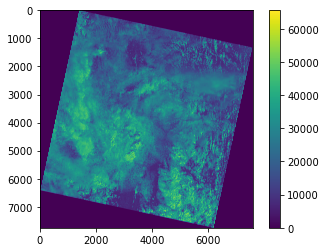

In [31]:
im = gdal.Open("LO08_L1TP_009056_20201108_20201120_01_T1_B4.TIF")
im = im.ReadAsArray().astype(np.float)
plt.imshow(im)
plt.colorbar()

In [33]:
b5 = gdal.Open("data/B5.tiff")
b5 = b5.ReadAsArray()
b4 = gdal.Open("data/B4.tiff")
b4 = b4.ReadAsArray()
b3 = gdal.Open("data/B3.tiff")
b3 = b3.ReadAsArray()
b2 = gdal.Open("data/B2.tiff")
b2 = b2.ReadAsArray()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


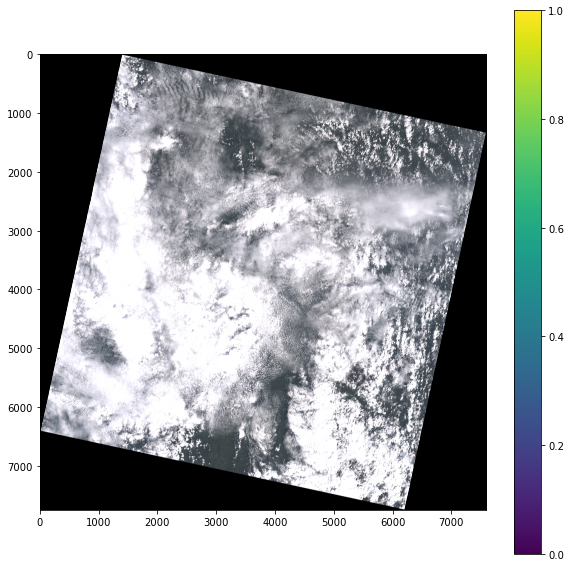

In [31]:
rgb = np.stack([b4, b3, b2], axis=-1)
rgb = rgb/rgb.max() * 2.0
plt.figure(figsize=(10,10))
plt.imshow(rgb)
plt.colorbar()

In [ ]:
FalseColor = np.stack([b5, b3, b2], axis=-1)
FalseColor = FalseColor/rgb.max() * 2.0
plt.figure(figsize=(10,10))
plt.imshow(FalseColor)
plt.colorbar()

In [ ]:
NDVI = (b5-b4)/(b5+b4)
plt.figure(figsize=(10,10))
plt.imshow(NDVI)
plt.colorbar()

### DN to radiance

First it get the 'B' and 'G' value from the dictionary that we created 
      for Landsat8. Then  by looping through the each pixel it converted the 
      pixel value to the radiance. and the return this value as an array

<center><img src="http://gsp.humboldt.edu/OLM_2017/courses/GSP_216_Online/images/calibration.PNG" width="1000"></center>

### Gain and Bias Method

 - L = (DN * G) + B

In [79]:
"""
  Arg: 
      data_array= (array of masked images path )
      band = band number 
  Returns:
      new_data_array = array of the radiance value of single masked image
  
  Function working:
      First it get the 'B' and 'G' value from the dictionary that we created 
      for landsat7. Then  by looping through the each pixel it converted the 
      pixel value to the radiance. and the return this value as an array
"""


def dn_to_radiance(data_array, band)  :

  # getting the G value 
  channel_gain = float(Landsat8_mlt_dict['RADIANCE_MULT_BAND_'+str(band)+' '])

  # Getting the B value
  channel_offset = float(Landsat8_mlt_dict['RADIANCE_ADD_BAND_'+str(band)+' '])

  # creating a temp array to store the radiance value
  new_data_array = np.empty_like(data_array)

  #loooping through the image
  for i,row in enumerate(data_array):
    for j, col in enumerate(row):

      # checking if the pixel value is not nan, to avoid background correction 
      if data_array[i][j] != np.nan:
        new_data_array[i][j] = data_array[i][j] * channel_gain +channel_offset
  print(f'Radiance calculated for band {band}')
  return new_data_array

### Dictionary

In [67]:
!curl -O -J https://landsat-pds.s3.amazonaws.com/c1/L8/009/056/LO08_L1TP_009056_20201108_20201120_01_T1/LO08_L1TP_009056_20201108_20201120_01_T1_MTL.txt

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  7509  100  7509    0     0   9639      0 --:--:-- --:--:-- --:--:--  9626


In [70]:
"""
  Creating a  Dictionary with key as the "property" and value as 
  numerical value given in the file.
  example  {'REFLECTANCE_MULT_BAND_8 ': ' 1.6439E-03'}
"""
Landsat8_mlt_dict = {}

with open('LO08_L1TP_009056_20201108_20201120_01_T1_MTL.txt', 'r') as _:
    for line in _:
        line = line.strip()
        if line != 'END':
            key, value = line.split('=')
            Landsat8_mlt_dict[key] = value
print( Landsat8_mlt_dict)


{'GROUP ': ' PROJECTION_PARAMETERS', 'ORIGIN ': ' "Image courtesy of the U.S. Geological Survey"', 'REQUEST_ID ': ' "P500ilp6jnht8_00005"', 'LANDSAT_SCENE_ID ': ' "LO80090562020313LGN00"', 'LANDSAT_PRODUCT_ID ': ' "LO08_L1TP_009056_20201108_20201120_01_T1"', 'COLLECTION_NUMBER ': ' 01', 'FILE_DATE ': ' 2020-11-20T01:38:43Z', 'STATION_ID ': ' "LGN"', 'PROCESSING_SOFTWARE_VERSION ': ' "LPGS_13.1.0"', 'END_GROUP ': ' L1_METADATA_FILE', 'DATA_TYPE ': ' "L1TP"', 'COLLECTION_CATEGORY ': ' "T1"', 'ELEVATION_SOURCE ': ' "GLS2000"', 'OUTPUT_FORMAT ': ' "GEOTIFF"', 'SPACECRAFT_ID ': ' "LANDSAT_8"', 'SENSOR_ID ': ' "OLI"', 'WRS_PATH ': ' 9', 'WRS_ROW ': ' 56', 'NADIR_OFFNADIR ': ' "NADIR"', 'TARGET_WRS_PATH ': ' 9', 'TARGET_WRS_ROW ': ' 56', 'DATE_ACQUIRED ': ' 2020-11-08', 'SCENE_CENTER_TIME ': ' "15:18:49.1025109Z"', 'CORNER_UL_LAT_PRODUCT ': ' 6.83095', 'CORNER_UL_LON_PRODUCT ': ' -76.72026', 'CORNER_UR_LAT_PRODUCT ': ' 6.83390', 'CORNER_UR_LON_PRODUCT ': ' -74.65970', 'CORNER_LL_LAT_PRODUCT '

### Mask

In [93]:
# Improting Image class from PIL module 
from PIL import Image 
Image.MAX_IMAGE_PIXELS = None

"""
   Arg: 
      img_path_arr = (array of images path that to be masked)
      output_folder = Name of the folder in which all the masked
                                masked images to be stored
  Returns:
      paths = list of path of msked images
  
  Function working:
      First is create a folder named <output_folder>
      This function take a list of paths of the images to masked and
      save the msked image in the <output_folder>. It mask the 
      region over the bhopal in rectangular shape the rectange is 
      950 pixel long and 500 pixel wide.
"""

def apply_mask(img_path_arr, output_folder):
  os.makedirs(output_folder, exist_ok= True)
  paths = list()
  # Opens a image in RGB mode 
  for i, img in enumerate(img_path_arr):
    im = Image.open(img) 
      
    # Setting the points for cropped image 
    left = 2000
    top = 1000
    right = 3000
    bottom = 2000
      
    # Cropped image of above dimension 
    # (It will not change orginal image) 
    im1 = im.crop((left, top, right, bottom)) 
      
    # Save the image 
    output_filename = str(output_folder+'/masked_{}.tif'.format(i))
    im1.save(output_filename)
    paths.append(output_filename)
  #os.close(output_folder)
  return paths
  #import cv2 
  #plt.imshow(cv2.imread('crop.tif'))

### Radiance to reflectance

<img src="https://www.researchgate.net/profile/Tri-Januar/publication/339029008/figure/tbl4/AS:857940328198147@1581560322757/Landsat-8-extra-terrestrial-solar-irradiation-ESUN-extra-terrestrial-solar.png" width="400">

In [81]:
from math import cos
import math

"""
  Arg: 
        arr = (array of images path of which reflectance to be calculated)
        ESUN = ESUN value of the band
    Returns:
        paths = array of reflectance value of the image
    
    Function working:
        First it read the 'd' and 'phi' value form the L7 dictionary
        The apply the reflectance formula to each pixel
"""
def radiance_to_reflectance(arr,ESUN,):

  #getting the d value
  d = float(Landsat8_mlt_dict['EARTH_SUN_DISTANCE '])

  # calculating rh phi value from theta
  phi = 90 - float(Landsat8_mlt_dict['SUN_ELEVATION '])

  # creating the temp array
  new_data_array = np.empty_like(arr)

  # loop to finf the reflectance
  for i,row in enumerate(arr):
    for j, col in enumerate(row):
      if arr[i][j] != np.nan:
        new_data_array[i][j] = np.pi *arr[i][j] * d**2/ (ESUN *cos(phi*math.pi/180))
  print(f"Reflectance of Band calculated")
  return new_data_array

In [91]:
from matplotlib.backends.backend_pgf import PdfPages
import matplotlib
"""Arg: 
      arr = (array of images to be plotted)
      bands = (ands of the images in correct order)
      output_filename = name of output files
      output_folder = name of the output folder
  
  Function working:
      First it create a folder with specified name, The it 
      plot the images in their respective colunmns. First column
      is RAW Image, second is DN to Radinace and third is the 
      Radiance to reflectance.
"""

def plot_figure(arr, bands, output_filename,output_folder):

  #creating a folder 
  os.makedirs(output_folder, exist_ok= True)

  #Setting the column the names
  cols = ['DN ', 'DN to Radiance', 'Radiance to Reflectance']

  #setting the row names
  rows = bands

  # increasing the font size of the plot text
  matplotlib.rcParams.update({'font.size': 22})

  # increasing the size of the plots
  fig, ax = plt.subplots(len(arr) ,3,figsize=(35,35), dpi =100)

  for axes, col in zip(ax[0], cols):
    axes.set_title(col)

  for axes, row in zip(ax[:,0], rows):
      axes.set_ylabel(row, rotation=0, size='large',)

  im_ratio = np.array(arr).shape[0]/np.array(arr).shape[1] #
  #fig(num=None, figsize=(5, 5), dpi=80, facecolor='w', edgecolor='k')

  #plotting the images
  for i,band in enumerate(arr):
    for j, img in enumerate(band):
      im1 = ax[i, j].imshow(arr[i][j], cmap ='Greys_r',) #row=0, col=0
      
      fig.colorbar(im1 ,ax=ax[i,j], fraction=0.02*im_ratio)
      if j==2:
        output_flname = str(output_folder+'/processed_{}.tif'.format(i))
        im = Image.fromarray(arr[i][j])

        #Saving the final reflactance image to use it in further code
        im.save(output_flname)

    print(f"Ploting {i+1} band")
  fig.tight_layout(pad=1.5)
  plt.show()
  plt.savefig(output_filename)
  #plt.close()

In [75]:
# creating the list of all image to be used
L8_images = ['LO08_L1TP_009056_20201108_20201120_01_T1_B2.tif',
          'LO08_L1TP_009056_20201108_20201120_01_T1_B3.tif',
          'LO08_L1TP_009056_20201108_20201120_01_T1_B4.tif',
          'LO08_L1TP_009056_20201108_20201120_01_T1_B5.tif',         
         ]

# creating the array of ESUN value in the increasing band order
ESUN_L8 = [2067, 1893, 1603, 972.6,]

Radiance calculated for band 2
Reflectance of Band calculated
completed1
Radiance calculated for band 3
Reflectance of Band calculated
completed2
Radiance calculated for band 4
Reflectance of Band calculated
completed3
Radiance calculated for band 5
Reflectance of Band calculated
completed4
Ploting 1 band
Ploting 2 band
Ploting 3 band
Ploting 4 band


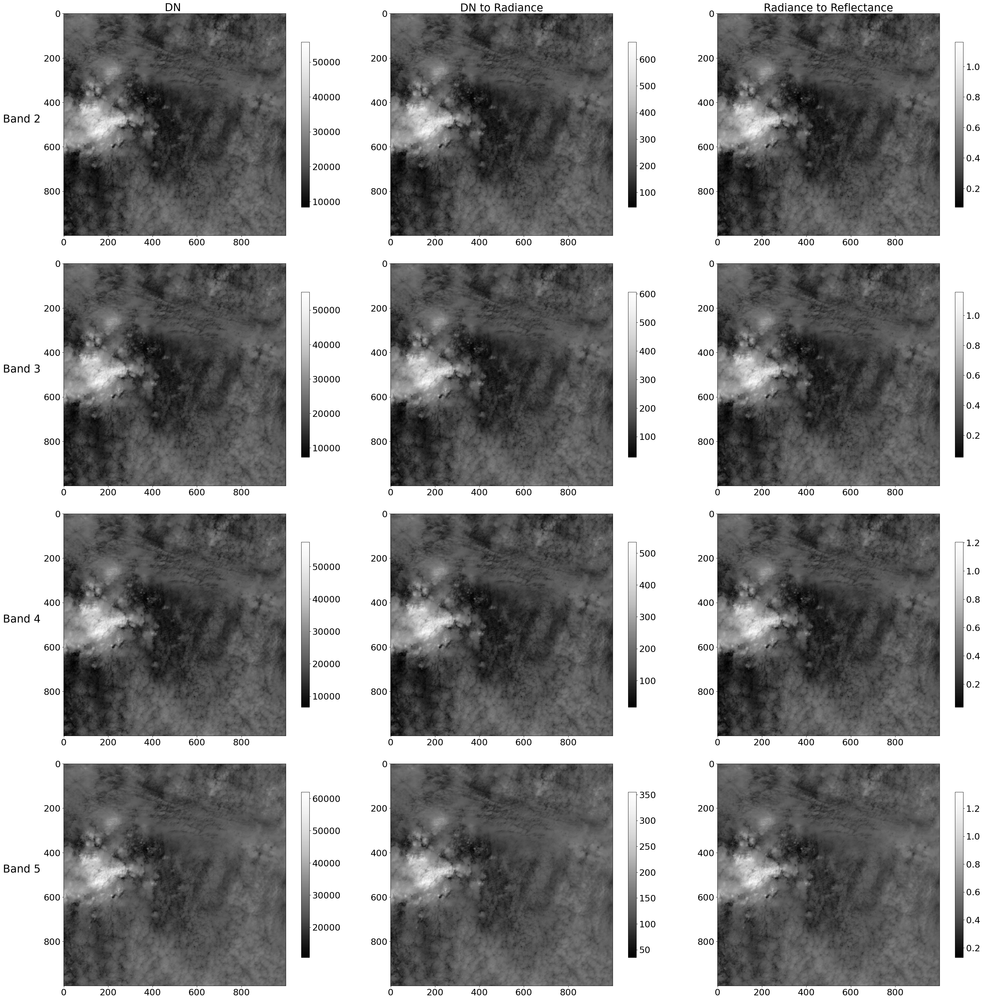

<Figure size 432x288 with 0 Axes>

In [94]:
imagelist = list()
masked_image_list = apply_mask(L8_images,'L8_masked')

for i,img in enumerate(masked_image_list):
  gdal_data = gdal.Open(img)
  gdal_band = gdal_data.GetRasterBand(1)
 
  data_array = gdal_data.ReadAsArray().astype(np.float)

  # replace missing values if necessary
  if np.any(data_array == 0):
    data_array[data_array == 0] = np.nan
  if i <=4:
    radiance = dn_to_radiance(data_array,i+2)
    reflectance = radiance_to_reflectance(radiance,ESUN_L8[i])
  else:
    radiance = dn_to_radiance(data_array,i+3)
    reflectance = radiance_to_reflectance(radiance,ESUN_L8[i])
  imagelist.append([data_array,radiance, reflectance])
  np.save('nmpyarr_2', imagelist) 
  print(f'completed{i+1}')
  
plot_figure(imagelist, ['Band 2            ', 'Band 3            ','Band 4            ', 'Band 5            '],'L8_B234567_gain_masked.png','L8_processed')


In [101]:
import xarray as xr
def combine_tifs(tif_list):
    """A function that combines a list of tifs in the same CRS
    and of the same extent into an xarray object

    Parameters
    ----------
    tif_list : list
        A list of paths to the tif files that you wish to combine.
        
    Returns
    -------
    An xarray object with all of the tif files in the listmerged into 
    a single object.

    """

    out_xr=[]
    for i, tif_path in enumerate(tif_list):
        out_xr.append(rxr.open_rasterio(tif_path, masked=True).squeeze())
        out_xr[i]["band"]=i+1
     
    return xr.concat(out_xr, dim="band")

In [113]:
# combining the unprocessed Landsat 7 images
landsat8_unprocessed_combimed = combine_tifs(masked_image_list)

# combining the final images of landsat 8
processed_L8_images = imagelist
landsat8_processed_combimed= combine_tifs(['L8_masked/masked_0.tif',
          'L8_masked/masked_1.tif',
          'L8_masked/masked_2.tif',
          'L8_masked/masked_3.tif',])
"""
landsat8_processed_combimed= combine_tifs(['LO08_L1TP_009056_20201108_20201120_01_T1_B2.tif',
          'LO08_L1TP_009056_20201108_20201120_01_T1_B3.tif',
          'LO08_L1TP_009056_20201108_20201120_01_T1_B4.tif',
          'LO08_L1TP_009056_20201108_20201120_01_T1_B5.tif',])
"""

"\nlandsat8_processed_combimed= combine_tifs(['LO08_L1TP_009056_20201108_20201120_01_T1_B2.tif',\n          'LO08_L1TP_009056_20201108_20201120_01_T1_B3.tif',\n          'LO08_L1TP_009056_20201108_20201120_01_T1_B4.tif',\n          'LO08_L1TP_009056_20201108_20201120_01_T1_B5.tif',])\n"

In [ ]:
!pip install earthpy

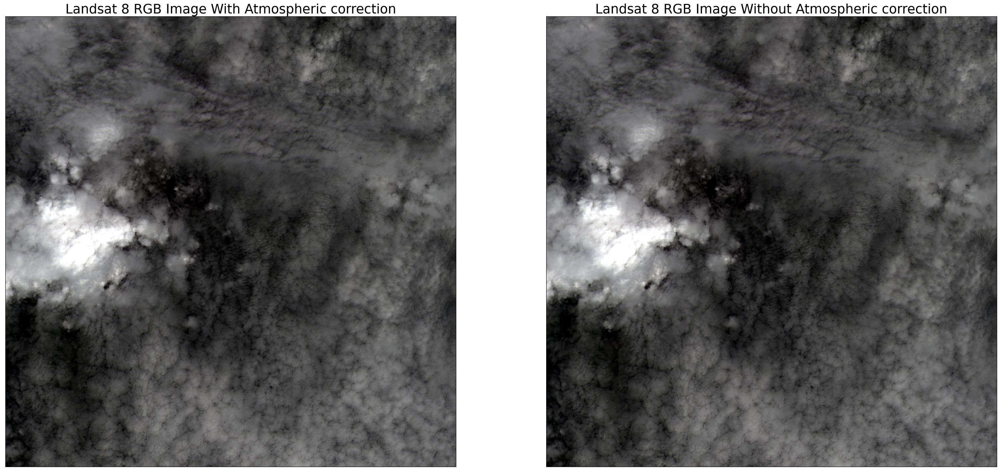

In [114]:
import earthpy.plot as ep
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(36, 18),dpi= 100)

# Plot of RGB composite image with polygon boundary
#bound_utm13N.boundary.plot(ax=ax1, color="black", zorder=10)
ax1 = ep.plot_rgb(
    landsat8_processed_combimed.values,
    rgb=(2, 1, 0),
    ax=ax1,
    stretch=True,
    
    str_clip=0.5,
    title="Landsat 8 RGB Image With Atmospheric correction",
)

# Plot of CIR composite image with polygon boundary
#bound_utm13N.boundary.plot(ax=ax2, color="black", zorder=10)
ax2 = ep.plot_rgb(
    landsat8_unprocessed_combimed.values,
    rgb=(2,1,0),
    ax=ax2,
    stretch=True,
    
    str_clip=0.5,
    title="Landsat 8 RGB Image Without Atmospheric correction",
)
plt.show()

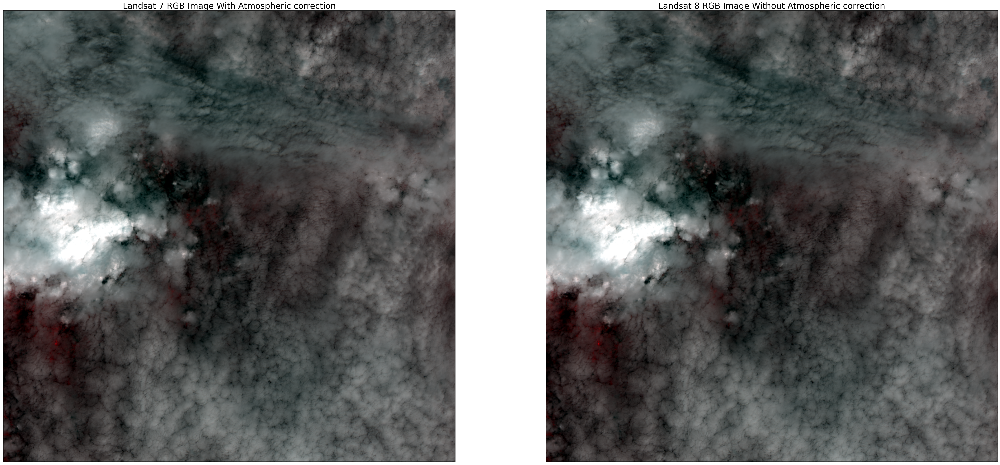

In [115]:
# plotting False color 
# images of Processsed image and Unprocessed image 
# side by side

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(56, 28),dpi= 150)

# Plot of RGB composite image with polygon boundary
#bound_utm13N.boundary.plot(ax=ax1, color="black", zorder=10)
ax1 = ep.plot_rgb(
    landsat8_processed_combimed.values,
    rgb=(3, 2, 1),
    ax=ax1,
    stretch=True,
    
    str_clip=0.5,
    title="Landsat 8 RGB Image With Atmospheric correction",
)

# Plot of CIR composite image with polygon boundary
#bound_utm13N.boundary.plot(ax=ax2, color="black", zorder=10)
ax2 = ep.plot_rgb(
    landsat8_unprocessed_combimed.values,
    rgb=(3,2,1),
    ax=ax2,
    stretch=True,
    
    str_clip=0.5,
    title="Landsat 8 RGB Image Without Atmospheric correction",
)
plt.show()

In [ ]:
#para saber el número de bandas
print(data.RasterCount)

In [ ]:
#para saber las dimensiones de un array
print(b4.shape)

In [ ]:
#Para saber número de filas y columnas
print(data.RasterYSize)
print(data.RasterXSize)
print('Image size is: {r} rows x {c} columns\n'.format(r=data.RasterYSize, c=data.RasterXSize))

In [ ]:
#para saber sistema de proyección
print(data.GetProjection())

In [ ]:
#para obtener el gdal.band
banda = data.GetRasterBand(1)
# How about some band statistics?
band_max, band_min, band_mean, band_stddev = banda.GetStatistics(0, 1)
print('Band range: {minimum} - {maximum}'.format(maximum=band_max,
                                                 minimum=band_min))
print('Band mean, stddev: {m}, {s}\n'.format(m=band_mean, s=band_stddev))

Para descargar la imagen:

In [3]:
!curl -O -J https://hello.planet.com/data/s/UG2TX98suVmmi9q/download

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  148M  100  148M    0     0  6752k      0  0:00:22  0:00:22 --:--:-- 7634k


In [12]:
satdat = rio.open("https://hello.planet.com/data/s/UG2TX98suVmmi9q/download")

In [139]:
type(satdat)
satdat.dtypes
print(satdat.profile)
print(satdat)
print(satdat.name)
print(satdat.width, satdat.height)    #para saber numero de filas y columnas
print(satdat.shape)                   #para saber numero de filas y columnas
print(satdat.crs)                     #para saber el sistema de coordenadas
print(satdat.transform)
print(satdat.count)                   #para saber cuantas bandas hay
print(satdat.indexes)
print(satdat.bounds)

{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': 0.0, 'width': 8341, 'height': 4213, 'count': 4, 'crs': CRS.from_epsg(32610), 'transform': Affine(3.0, 0.0, 544491.0,
       0.0, -3.0, 4191009.0), 'blockxsize': 256, 'blockysize': 256, 'tiled': True, 'compress': 'lzw', 'interleave': 'pixel'}
<open DatasetReader name='https://hello.planet.com/data/s/UG2TX98suVmmi9q/download' mode='r'>
https://hello.planet.com/data/s/UG2TX98suVmmi9q/download
8341 4213
(4213, 8341)
EPSG:32610
| 3.00, 0.00, 544491.00|
| 0.00,-3.00, 4191009.00|
| 0.00, 0.00, 1.00|
4
(1, 2, 3, 4)
BoundingBox(left=544491.0, bottom=4178370.0, right=569514.0, top=4191009.0)


This transformation, implemented as an Affine object, defines how a change of 1 pixel in either direction (row or column) translates into crs coordinate changes using 6 parameters that are (in this order and all in the same units as the transformation’s crs): the change in x as a function of the change in pixel column (+30m for +1 pixel), the change in x as a function of the change in pixel row (0 in this case), the x coordinate origin (404385.0m), the change in y as a function of the change in pixel column (0 in this case), the change in y as a function of the change in pixel row (-30m for +1 pixel), and the y coordinate origin (1225815.0m here). You can consider the transformation to consist of two parts: a “rotation matrix” and the dataset’s crs coordinate origin

In [7]:
raster.transform

Affine(30.0, 0.0, 404385.0,
       0.0, -30.0, 1225815.0)

In [137]:
blue, green, red, nir = satdat.read()

In [138]:
# Or read the entire dataset into a single 3D array:
data = satdat.read()

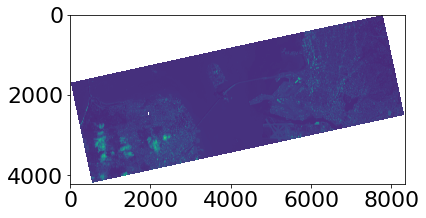

<AxesSubplot:>

In [134]:
blue = np.where(blue==0,np.nan, blue)
show(blue)

In [143]:
B1=satdat.read(1)
B2=satdat.read(2)
B3=satdat.read(3)

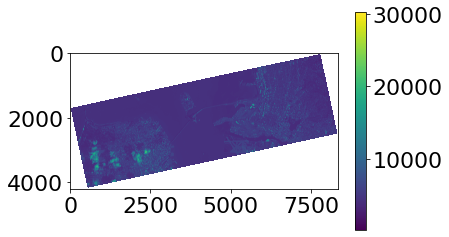

In [144]:
b1 = np.where(B1==0,np.nan, B1)
plt.imshow(b1)
plt.colorbar()

In [141]:
vector=B1.ravel()
vector_rec=vector[vector!=0]
vector_rec.mean()

5056.31088110179

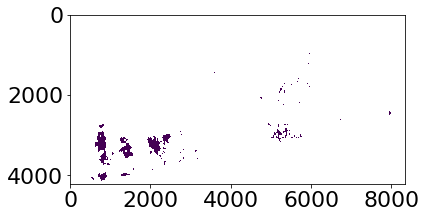

<AxesSubplot:>

In [147]:
check = np.logical_and ( B1 > 5000, B1 < 30000 )
B1_rango=np.where(check,1,np.nan)
show(B1_rango)

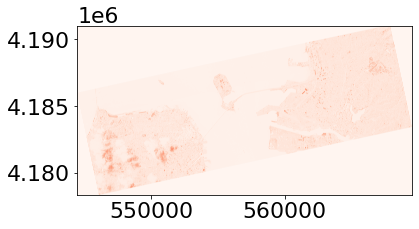

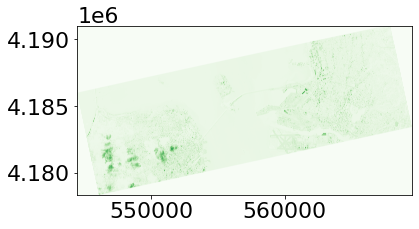

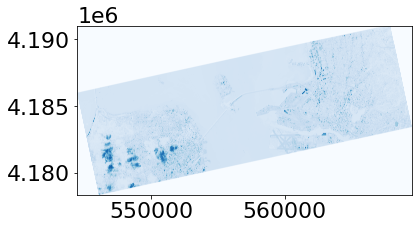

<AxesSubplot:>

In [148]:
show((satdat, 4), cmap='Reds')
show((satdat, 3), cmap='Greens')
show((satdat, 2), cmap='Blues')

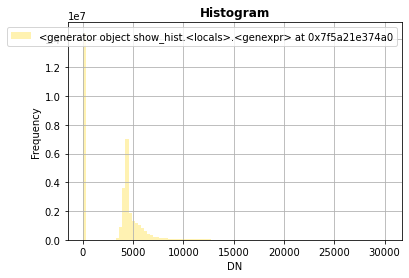

In [29]:
show_hist(B1, bins=100, lw=0.0, stacked=False, alpha=0.3,histtype='stepfilled', title="Histogram")

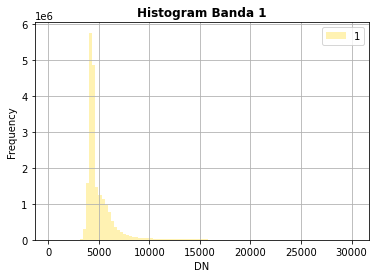

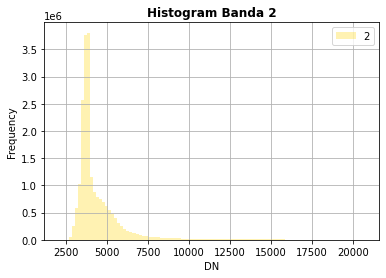

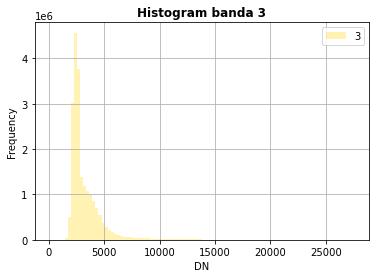

In [35]:
show_hist((raster,1), bins=100, lw=0.0, stacked=False, alpha=0.3,histtype='stepfilled', title="Histogram Banda 1")
show_hist((raster,2), bins=100, lw=0.0, stacked=False, alpha=0.3,histtype='stepfilled', title="Histogram Banda 2")
show_hist((raster,3), bins=100, lw=0.0, stacked=False, alpha=0.3,histtype='stepfilled', title="Histogram banda 3")

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


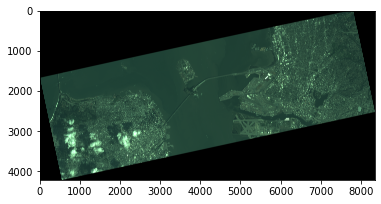

<AxesSubplot:>

In [30]:
from rasterio.plot import show, adjust_band
imgdata = np.array([adjust_band(raster.read(i)) for i in (3,2,1)])
show(imgdata*1.5)  # factor to increase brightness

In [154]:
from shapely.geometry import Polygon
roi = Polygon([(55000, 41800),
               (55000, 41900),
               (56000, 41900),
               (56000,41800)])
print(roi)
BoundingBox(left=590520.0, bottom=5780620.0, right=600530.0, top=5790630.0)

POLYGON ((55000 41800, 55000 41900, 56000 41900, 56000 41800, 55000 41800))


In [ ]:
from rasterio.mask import mask
crop_img= mask(B3, shapes=[roi], crop=True)

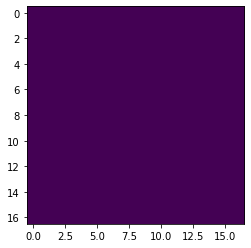

In [60]:
show(crop_img)

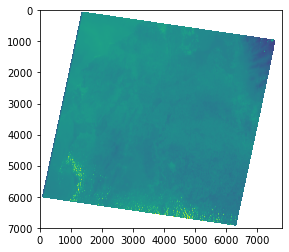

In [8]:
vector=B1.ravel()
vector_rec=vector[vector!=0]
vector_rec.mean()

B1_nan=np.where(B1==0,np.nan,B1)
show(B1_nan)

<ipython-input-9-ceccc29f3041>:1: RuntimeWarning: invalid value encountered in greater
  check = np.logical_and ( B1_nan > 100, B1_nan < 120 )
<ipython-input-9-ceccc29f3041>:1: RuntimeWarning: invalid value encountered in less
  check = np.logical_and ( B1_nan > 100, B1_nan < 120 )


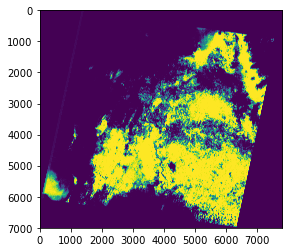

In [9]:
check = np.logical_and ( B1_nan > 100, B1_nan < 120 )
B1_rango=np.where(check,1,0)
show(B1_rango)

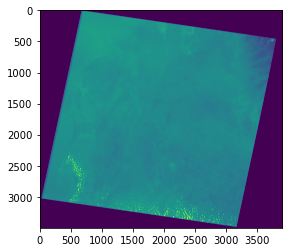

In [49]:
from rasterio.enums import Resampling
resample_factor = 0.5 # >1: upsample, <1: downsample

with rio.open(r'G:\My Drive\CATEDRA\SENSORES REMOTOS\Imagen\barranquilla\LE70090532003066EDC00_B1.tif') as dataset:

    imgdata = dataset.read(out_shape=(dataset.count,
                   int(dataset.height * resample_factor),
                   int(dataset.width * resample_factor)),
                resampling=Resampling.bilinear)

    transform = dataset.transform * dataset.transform.scale(
        (dataset.width / imgdata.shape[-1]),
        (dataset.height / imgdata.shape[-2]))
    
    show(imgdata)

In [50]:
imgdata.shape

(1, 3500, 3900)

In [54]:
from rasterio.warp import calculate_default_transform, reproject
from rasterio.crs import CRS

new_crs = CRS.from_epsg(4326)  # WGS84

with rio.open(r'G:\My Drive\CATEDRA\SENSORES REMOTOS\Imagen\barranquilla\LE70090532003066EDC00_B1.tif') as dataset:
    new_transform, width, height = calculate_default_transform(
        dataset.crs, new_crs, 
        dataset.width, dataset.height, *dataset.bounds)
    imgdata = np.array([dataset.read(i) for i in dataset.indexes])
    new_imgdata = np.zeros(imgdata.shape)
    
    reproject(source=imgdata,
              destination=new_imgdata,
              src_transform=dataset.transform,
              src_crs=dataset.crs,
              dst_transform=new_transform,
              dst_crs=new_crs,
              resampling=Resampling.nearest)
  

IndentationError: unexpected indent (<ipython-input-54-9917cde55517>, line 20)

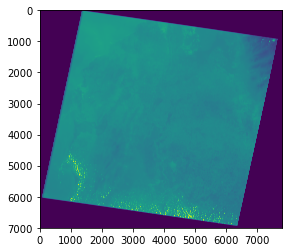

In [55]:
show(new_imgdata)

In [ ]:
#Para calcular indixes
#Next we need to tweak the behaviour of numpy a little bit. By default numpy will #complain about dividing with zero values. 
#We need to change that behaviour because we have a lot of 0 values in our data.
np.seterr(divide='ignore', invalid='ignore')
#Now we need to initialize with zeros before we do the calculations 
NDVI = np.empty(B4.shape, dtype=rio.float32)
#First, we can create a filter where we calculate the values on such pixels that have a value larger than 0. siempre para dos condiciones
check = np.logical_or ( matriz_B4 > 0, matriz_B5 > 0 )
#aplicr formula
NDVI = np.where ( check,  (matriz_B5 - matriz_B4 ) / ( matriz_B5 + matriz_B4 ), -999 )
NDVI=np.where(NDVI==-999,np.nan,NDVI)
plt.imshow(NDVI)
plt.colorbar();

ndvi = np.zeros(B5.shape, dtype=rio.float32)
ndvi = np.divide(matriz_B5 - matriz_B4, matriz_B5 + matriz_B4, where=(matriz_B5 - matriz_B4)!=0)
ndvi[ndvi == 0] = np.nan
plt.imshow(ndvi)
plt.colorbar();

np.nanmean(NDVI)
show(NDVI, cmap='summer');

#Para exportar
meta=B4.profile
B4_transform = meta['transform']
B4_crs = meta['crs']

with rio.open('G:/My Drive/SENSORES REMOTOS/TALLERES/Taller 3_NDVI/Imagen/barranquilla/NDVI.TIF', 'w', 
              driver='Gtiff',height=matriz_B4.shape[0],width=matriz_B4.shape[1],count=1,
              dtype='float64',nodata=-999,crs=B4_crs,transform=B4_transform) as dst:
    dst.write(NDVI,1)

# Satellite Imagery Analysis using Python

#Import Modules

In [ ]:
!pip install earthpy

In [3]:
from glob import glob

import earthpy as et
import earthpy.spatial as es
import earthpy.plot as ep

import rasterio as rio
from rasterio.plot import plotting_extent
from rasterio.plot import show
from rasterio.plot import reshape_as_raster, reshape_as_image

import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

import plotly.graph_objects as go

np.seterr(divide='ignore', invalid='ignore')

{'divide': 'warn', 'over': 'warn', 'under': 'ignore', 'invalid': 'warn'}

## Sentine 2 Band Details

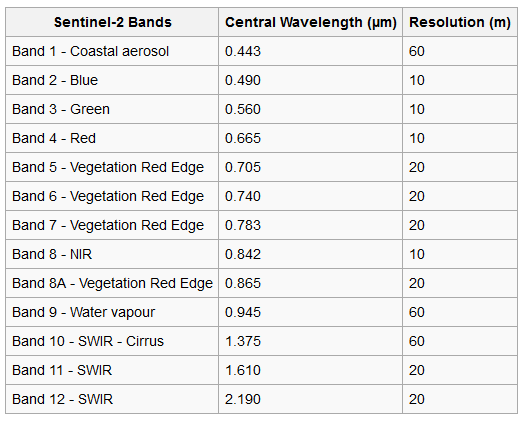

# DataSet

## Sundarbans Satellite Data

In [4]:
S_sentinel_bands = glob(r"G:\My Drive\CATEDRA\ANALISIS GEOESPACIAL\DATA\sundarbans_data/*B?*.tiff")
S_sentinel_bands.sort()
S_sentinel_bands

['G:\\My Drive\\CATEDRA\\ANALISIS GEOESPACIAL\\DATA\\sundarbans_data\\2020-01-27-00_00_2020-01-27-23_59_Sentinel-2_L2A_B01_(Raw).tiff',
 'G:\\My Drive\\CATEDRA\\ANALISIS GEOESPACIAL\\DATA\\sundarbans_data\\2020-01-27-00_00_2020-01-27-23_59_Sentinel-2_L2A_B02_(Raw).tiff',
 'G:\\My Drive\\CATEDRA\\ANALISIS GEOESPACIAL\\DATA\\sundarbans_data\\2020-01-27-00_00_2020-01-27-23_59_Sentinel-2_L2A_B03_(Raw).tiff',
 'G:\\My Drive\\CATEDRA\\ANALISIS GEOESPACIAL\\DATA\\sundarbans_data\\2020-01-27-00_00_2020-01-27-23_59_Sentinel-2_L2A_B04_(Raw).tiff',
 'G:\\My Drive\\CATEDRA\\ANALISIS GEOESPACIAL\\DATA\\sundarbans_data\\2020-01-27-00_00_2020-01-27-23_59_Sentinel-2_L2A_B05_(Raw).tiff',
 'G:\\My Drive\\CATEDRA\\ANALISIS GEOESPACIAL\\DATA\\sundarbans_data\\2020-01-27-00_00_2020-01-27-23_59_Sentinel-2_L2A_B06_(Raw).tiff',
 'G:\\My Drive\\CATEDRA\\ANALISIS GEOESPACIAL\\DATA\\sundarbans_data\\2020-01-27-00_00_2020-01-27-23_59_Sentinel-2_L2A_B07_(Raw).tiff',
 'G:\\My Drive\\CATEDRA\\ANALISIS GEOESPACIAL\\D

In [5]:
l = []
for i in S_sentinel_bands:
  with rio.open(i, 'r') as f:
    l.append(f.read(1))


In [7]:
arr_st = np.stack(l)

In [ ]:
print(f'Height: {arr_st.shape[1]}\nWidth: {arr_st.shape[2]}\nBands: {arr_st.shape[0]}')

In [8]:
arr_st.shape

(12, 954, 298)

## Visualize Data
### Bands

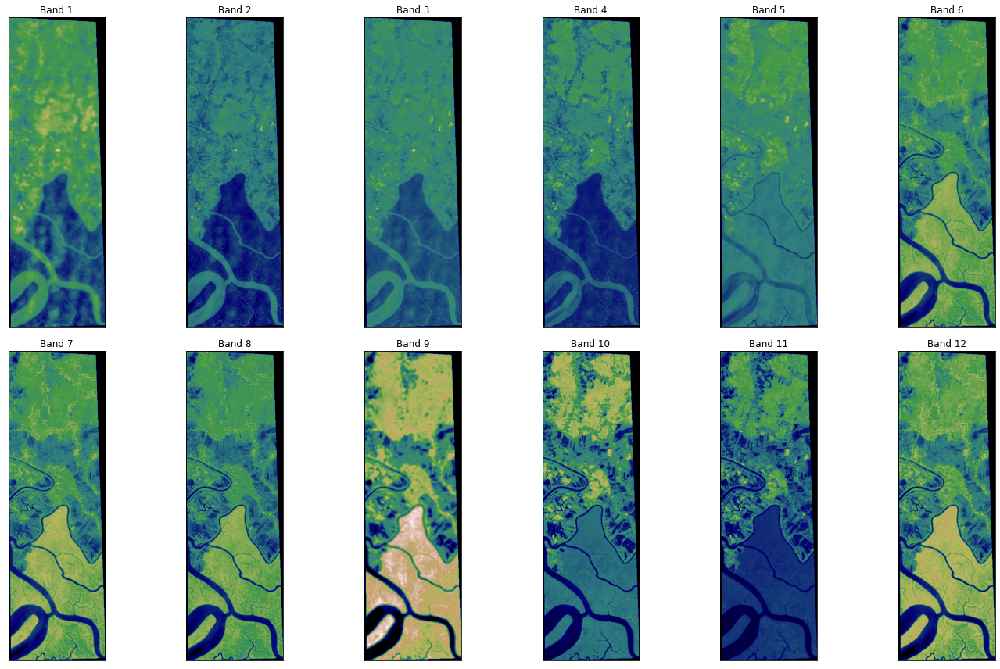

In [9]:
ep.plot_bands(arr_st, cmap = 'gist_earth', figsize = (20, 12), cols = 6, cbar = False)
plt.show()

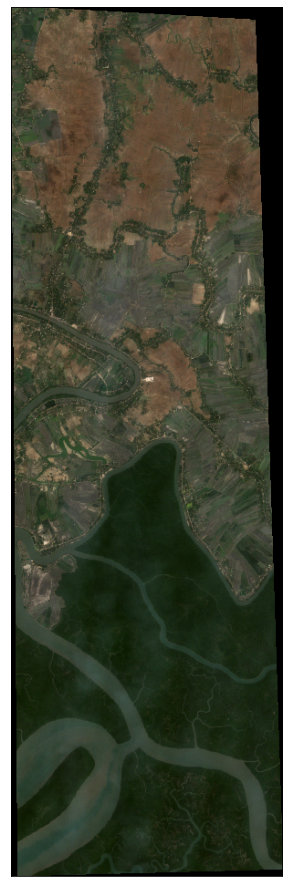

In [10]:
rgb = ep.plot_rgb(arr_st, 
                  rgb=(3,2,1), 
                  figsize=(10, 16), 
                # title='RGB Composite Image'
                  )

plt.show()

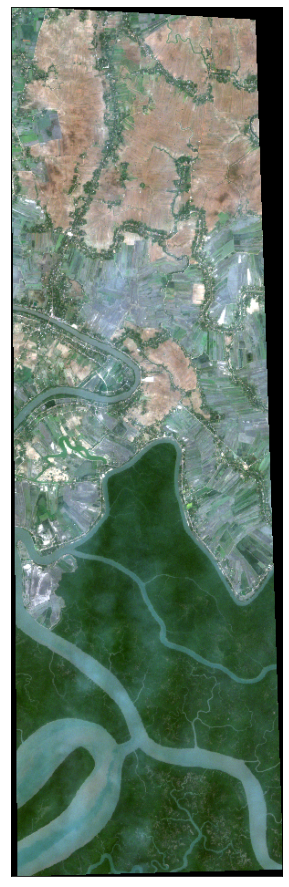

In [11]:
ep.plot_rgb(
    arr_st,
    rgb=(3, 2, 1),
    stretch=True,
    str_clip=0.2,
    figsize=(10, 16),
    # title="RGB Composite Image with Stretch Applied",
)

plt.show()

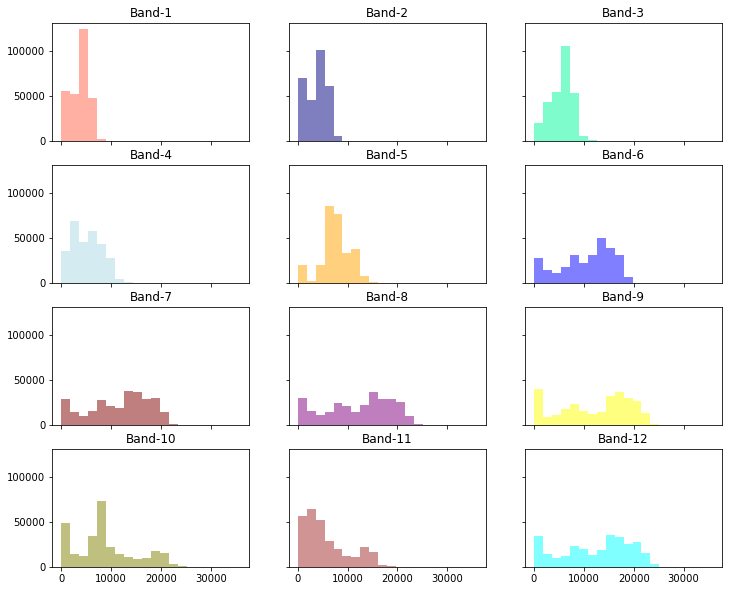

In [12]:
colors = ['tomato', 'navy', 'MediumSpringGreen', 'lightblue', 'orange', 'blue',
          'maroon', 'purple', 'yellow', 'olive', 'brown', 'cyan']

ep.hist(arr_st, 
         colors = colors,
        title=[f'Band-{i}' for i in range(1, 13)], 
        cols=3, 
        alpha=0.5, 
        figsize = (12, 10)
        )

plt.show()

# Vegetation and soils indices

## Normalized Difference Vegetation Index (NDVI)
```
NDVI = ((NIR - Red)/(NIR + Red))
```

* NIR = pixel values from the near-infrared band
* Red = pixel values from the red band

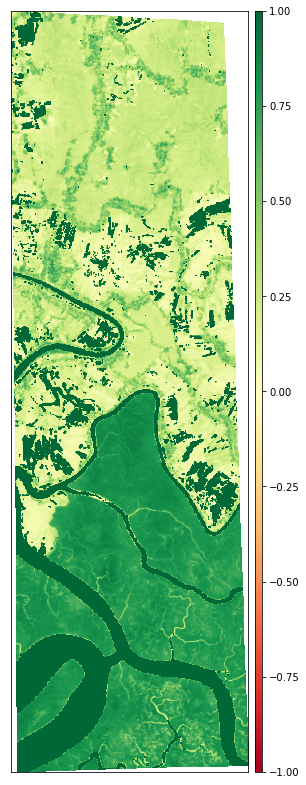

In [13]:
ndvi = es.normalized_diff(arr_st[7], arr_st[3])

ep.plot_bands(ndvi, cmap="RdYlGn", cols=1, vmin=-1, vmax=1, figsize=(10, 14))

plt.show()

## Soil-Adjusted Vegetation Index (SAVI) 

```
SAVI = ((NIR - Red) / (NIR + Red + L)) x (1 + L)
```
* NIR = pixel values from the near infrared band
* Red = pixel values from the near red band
* L = amount of green vegetation cover

In [14]:
L = 0.5

savi = ((arr_st[7] - arr_st[3]) / (arr_st[7] + arr_st[3] + L)) * (1 + L)

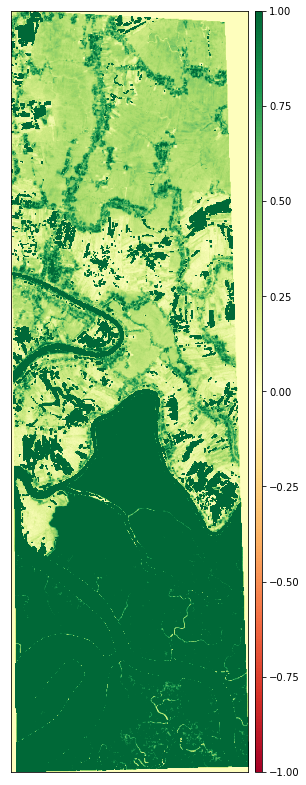

In [15]:
ep.plot_bands(savi, cmap="RdYlGn", cols=1, vmin=-1, vmax=1, figsize=(10, 14))

plt.show()

## Visible Atmospherically Resistant Index (VARI)
```
VARI = (Green - Red)/ (Green + Red - Blue)
```
* Green = pixel values from the green band
* Red= pixel values from the red band
* Blue = pixel values from the blue band

In [16]:
vari = (arr_st[2] - arr_st[3])/ (arr_st[2] + arr_st[3] - arr_st[1])

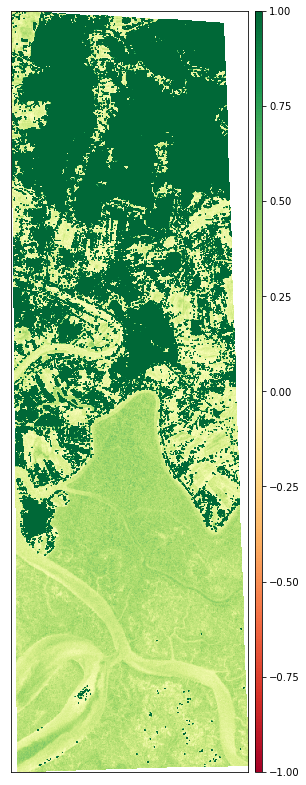

In [17]:
ep.plot_bands(vari, cmap="RdYlGn", cols=1, vmin=-1, vmax=1, figsize=(10, 14))

plt.show()

## Distribution of NDVI, SAVI, and VARI pixel values

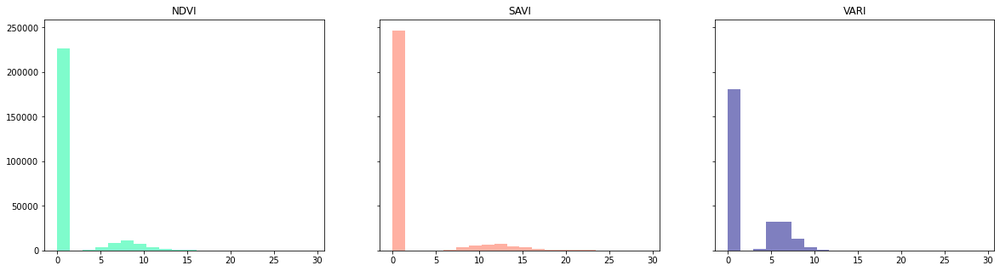

In [18]:
ep.hist(np.stack([ndvi, savi, vari]), 
        alpha=0.5,
        cols=3, 
        figsize=(20, 5),
        title = ['NDVI', 'SAVI', 'VARI'],
        colors = ['mediumspringgreen', 'tomato', 'navy'])
plt.show()

# Water Indices

## Modified Normalized Difference Water Index (MNDWI) 

```
MNDWI = (Green - SWIR) / (Green + SWIR)
```
* Green = pixel values from the green band
* SWIR = pixel values from the short-wave infrared band

In [19]:
mndwi = es.normalized_diff(arr_st[2], arr_st[10])

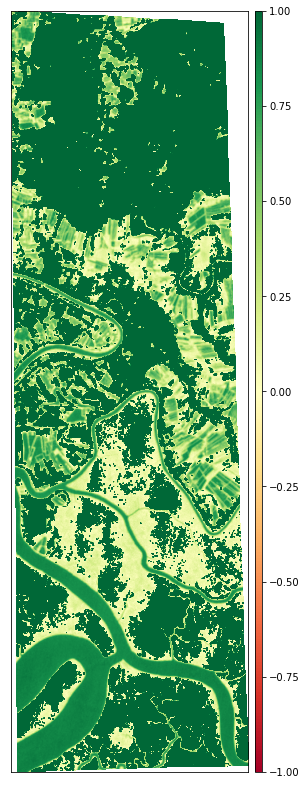

In [20]:
ep.plot_bands(mndwi, cmap="RdYlGn", cols=1, vmin=-1, vmax=1, figsize=(10, 14))

plt.show()

## Normalized Difference Moisture Index (NDMI) 

```
NDMI = (NIR - SWIR1)/(NIR + SWIR1)
```
* NIR = pixel values from the near infrared band
* SWIR1 = pixel values from the short-wave infrared 1 band

In [21]:
ndmi = es.normalized_diff(arr_st[7], arr_st[10])

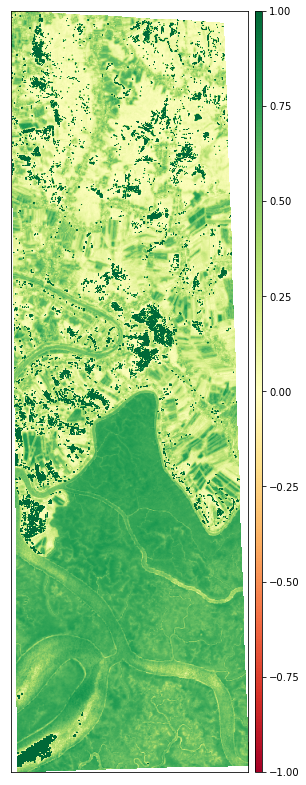

In [22]:
ep.plot_bands(ndmi, cmap="RdYlGn", cols=1, vmin=-1, vmax=1, figsize=(10, 14))

plt.show()

# Geology Indices

## Clay Minerals
```
Clay Minerals Ratio = SWIR1 / SWIR2
```
* SWIR1 = pixel values from the short-wave infrared 1 band
* SWIR2 = pixel values from the short-wave infrared 2 band

In [23]:
cmr = np.divide(arr_st[10], arr_st[11])

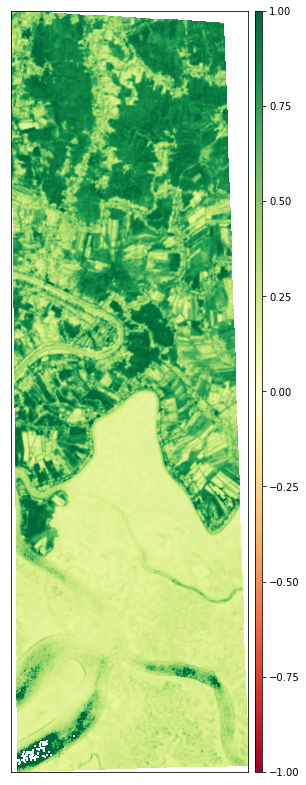

In [24]:
ep.plot_bands(cmr, cmap="RdYlGn", cols=1, vmin=-1, vmax=1, figsize=(10, 14))

plt.show()

## Ferrous Minerals

```
Ferrous Minerals Ratio = SWIR / NIR
```

* SWIR= pixel values from the short-wave infrared band
* NIR = pixel values from the near infrared band

In [25]:
fmr = np.divide(arr_st[10], arr_st[7])

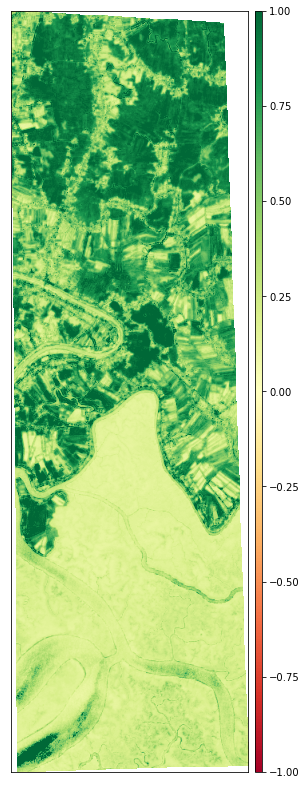

In [26]:
ep.plot_bands(fmr, cmap="RdYlGn", cols=1, vmin=-1, vmax=1, figsize=(10, 14))

plt.show()

In [ ]:
#importar uan imagen compuesta
composite = gdal.Open(r'G:\My Drive\CATEDRA\SENSORES REMOTOS\Imagen\barranquilla\Composite_LE70090532003066EDC00.tif')

#para saber el número de bandas
print(composite.RasterCount)

In [ ]:
# Allocate our array using the first band's datatype
image_datatype = composite.GetRasterBand(1).DataType

# Allocate our array, but in a more efficient way
image = np.zeros((composite.RasterYSize, composite.RasterXSize, composite.RasterCount))

In [ ]:
# Ajustar el indice y pasar a capa image
for b in range(composite.RasterCount):
    # Remember, GDAL index is on 1, but Python is on 0 -- so we add 1 for our GDAL calls
    bandas = composite.GetRasterBand(b + 1)
    
    # Read in the band's data into the third dimension of our array
    image[:, :, b] = bandas.ReadAsArray()

In [ ]:
print(image)
print(image.shape)

In [ ]:
#calcular el NDVI utilizando bandas
b2 = np.ndarray.flatten(image[:, :, 2])
b3 = np.ndarray.flatten(image[:, :, 3])

#plotear scatter
plt.scatter(b2, b3)

In [ ]:
#con formato
plt.scatter(b2, b3, color='r', marker='o')
plt.xlabel('Red Reflectance')
plt.ylabel('NIR label')
plt.title('Red vs NIR')

In [ ]:
# use "imshow" for an image -- nir in first subplot, red in second
plt.subplot(121)
plt.imshow(image[:, :, 3], cmap=plt.cm.Greys)
plt.colorbar()

In [ ]:
# Now red band in the second subplot (indicated by last of the 3 numbers)
plt.subplot(122)
plt.imshow(image[:, :, 2], cmap=plt.cm.Greys)
plt.colorbar()

In [ ]:
#calcular el NDVI utilizando la imagen compuesta
ndvi1 = ((image[:, :, 3] - image[:, :, 2]) / (image[:, :, 3] + image[:, :, 2])).astype(np.float64)
plt.imshow(ndvi1)
plt.colorbar()

In [ ]:
#calcular el NDVI utilizando la imagen compuesta
b3= image[:, :, 3]
b2= image[:, :, 2]
suma= b3+b2
resta=b3-b2
ndvi2= (resta/suma).astype(np.float64)
plt.imshow(ndvi2)
plt.colorbar()

In [ ]:
# create new file
driver = gdal.GetDriverByName('GTiff')
file = driver.Create( 'G:/My Drive/ndvi.tif', composite.RasterXSize , composite.RasterYSize , 1)
file.GetRasterBand(1).WriteArray(ndvi3)

In [ ]:
# spatial ref system
proj = composite.GetProjection()
georef = composite.GetGeoTransform()
file.SetProjection(proj)
file.SetGeoTransform(georef)
file.GetRasterBand(1).SetNoDataValue(-9999)
file.FlushCache()

## Unsupervised Learning
### Preprocessing 

In [ ]:
x = np.moveaxis(arr_st, 0, -1)
x.shape

In [ ]:
x.reshape(-1, 12).shape, 954*298

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

X_data = x.reshape(-1, 12)

scaler = StandardScaler().fit(X_data)

X_scaled = scaler.transform(X_data)

X_scaled.shape

## Principal Component Analysis (PCA)

In [ ]:
pca = PCA(n_components = 4)

pca.fit(X_scaled)

data = pca.transform(X_scaled)

In [ ]:
data.shape

In [ ]:
pca.explained_variance_ratio_

In [ ]:
np.sum(pca.explained_variance_ratio_)

In [ ]:
ep.plot_bands(np.moveaxis(data.reshape((954, 298, data.shape[1])), -1, 0),
              cmap = 'gist_earth',
              cols = 4,
              title = [f'PC-{i}' for i in range(1,5)])

plt.show()

## *k* - Means 

In [ ]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters = 6, random_state = 11)

kmeans.fit(data)

In [ ]:
labels = kmeans.predict(data)

In [ ]:
np.unique(labels)

In [ ]:
ep.plot_bands(labels.reshape(954, 298), cmap=ListedColormap(['darkgreen', 'green', 'black', '#CA6F1E', 'navy', 'forestgreen']))
plt.show()

In [ ]:
import plotly.express as px

fig = px.imshow(labels.reshape(954, 298), 
          color_continuous_scale = ['darkgreen', 'green', 'black', '#CA6F1E', 'navy', 'forestgreen'])

fig.update_xaxes(showticklabels=False)

fig.update_yaxes(showticklabels=False)

fig.update_layout(
    autosize=False,
    width=500,
    height=1000,
    margin=dict(
        l=50,
        r=50,
        b=100,
        t=100,
        pad=4
    ),
    # paper_bgcolor="LightSteelBlue",
)

### Kenya example

In [8]:
dataarray = rxr.open_rasterio('https://drive.google.com/u/0/uc?id=1Kb3gP9v-xsNJ_AzGJE1jbatvdKtvf0zx&export=download')
dataarray

<xarray.DataArray (band: 1, y: 213, x: 179)>
array([[[nan, nan, ..., nan, nan],
        [nan, nan, ..., nan, nan],
        ...,
        [nan, nan, ..., nan, nan],
        [nan, nan, ..., nan, nan]]], dtype=float32)
Coordinates:
  * band         (band) int64 1
  * y            (y) float64 4.641 4.596 4.551 4.507 ... -4.791 -4.836 -4.881
  * x            (x) float64 33.91 33.96 34.0 34.05 ... 41.77 41.82 41.86 41.91
    spatial_ref  int64 0
Attributes:
    scale_factor:  1.0
    add_offset:    0.0
    long_name:     elevation
    grid_mapping:  spatial_ref

Without going into the details of this data format, we can see that our data has a dimension of 218 by 179, with only one band: the elevation data itself. We can also see that the x values are somewhere around 30 to 42, while the y values are around -5 to 5, so they look like reasonable values for coordinates.

To get a bit more familiar with our data, we can easily convert it into a pandas dataset and display that. We can see that it is indeed a gridded dataset, with the coordinates being the row and column headers and the elevation data in meters being the values. (NaN or Not a Number values show missing values as I cropped the data to the shape of the borders of Kenya.)

In [9]:
# dataarray[0] is the first band in the dataarray
df = dataarray[0].to_pandas()
# display the first 10 columns and 10 rows
df.iloc[0:20, 0:20]

x,33.911327,33.956243,34.001159,34.046074,34.090990,34.135906,34.180822,34.225737,34.270653,34.315569,34.360485,34.405400,34.450316,34.495232,34.540148,34.585063,34.629979,34.674895,34.719811,34.764727
y,,,,,,,,,,,,,,,,,,,,
4.641321,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4.596405,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,539.0,519.0,512.0,499.0,488.0,484.0,477.0,474.0,471.0,470.0
4.551489,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,561.0,634.0,566.0,523.0,501.0,490.0,487.0,482.0,478.0,477.0,475.0
4.506573,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,577.0,587.0,847.0,1040.0,674.0,508.0,499.0,497.0,490.0,486.0,483.0,478.0
4.461658,NaN,NaN,NaN,NaN,NaN,NaN,NaN,610.0,584.0,605.0,850.0,1010.0,639.0,517.0,505.0,502.0,497.0,489.0,486.0,480.0
4.416742,NaN,NaN,NaN,NaN,NaN,NaN,660.0,641.0,603.0,617.0,1145.0,770.0,569.0,532.0,518.0,513.0,506.0,496.0,492.0,485.0
4.371826,NaN,NaN,NaN,NaN,NaN,697.0,681.0,646.0,634.0,657.0,986.0,624.0,578.0,541.0,531.0,526.0,516.0,505.0,500.0,492.0
4.326910,NaN,NaN,NaN,NaN,740.0,706.0,690.0,647.0,653.0,690.0,1117.0,726.0,570.0,547.0,537.0,533.0,522.0,509.0,503.0,495.0
4.281995,NaN,NaN,NaN,797.0,758.0,714.0,695.0,667.0,664.0,711.0,1138.0,688.0,583.0,563.0,552.0,547.0,530.0,516.0,510.0,502.0


We can even export and download our data as a CSV file and open it in Excel if we want to.

In [11]:
# You can find the converted file by clicking the 'Files' icon on the left
df.to_csv('kenya/elevation_export_5000.csv')